## File Description

**File Name**: `experiment_tf-idf vs. human readable topic cluster label.ipynb`

**Description**:  
This Jupyter notebook contains an experiment comparing the performance of KeyBERT-based topic labels with human-readable topic cluster labels. The notebook explores the effectiveness of both approaches in aligning topic labels with their corresponding cluster centroids. It includes sections for data preprocessing, KeyBERT keyword extraction, human-readable label generation, and the evaluation of both methods using metrics such as Cosine Similarity and Euclidean Distance.

Key components:
- **Data Loading & Preprocessing**: Prepares the dataset for analysis, including cleaning and normalization steps.
- **KeyBERT Labeling**: Uses KeyBERT, a keyword extraction technique based on BERT embeddings, to generate topic labels from the text data.
- **Human Readable Labeling**: Applies large language models (LLMs) to produce more intuitive and interpretable labels for the topic clusters.
- **Evaluation Metrics**: Compares the two labeling methods by calculating pairwise Cosine Similarity and Euclidean Distance between the cluster centroids and the respective labels.
- **Visualization**: Includes heatmaps and other visual aids to illustrate the alignment between the labels and the clusters.

This notebook serves as a comparison experiment to determine which labeling technique results in a better match with the underlying data clusters.

## Conclusion

The results of this experiment indicate that, on average, human-readable labels align better with their corresponding cluster centroids than the labels generated using the KeyBERT approach. This suggests that human-readable labels, likely enhanced by the contextual understanding provided by large language models (LLMs), capture the semantic relationships within the data more effectively. While KeyBERT remains a useful method for automated keyword extraction, its performance in this context shows limitations compared to the more interpretable human-readable labels, which provide a clearer and more accurate representation of the topic clusters.


- **KeyBERT Labeling**: Uses KeyBERT, a keyword extraction technique based on BERT embeddings, to generate topic labels from the text data.

/w0/tmp/slurm_yc656703.49807071/ipykernel_247670/368536997.py:10: DtypeWarning:

Columns (0) have mixed types. Specify dtype option on import or set low_memory=False.

/home/yc656703/.local/lib/python3.9/site-packages/huggingface_hub/file_download.py:1132: FutureWarning:

`resume_download` is deprecated and will be removed in version 1.0.0. Downloads always resume when possible. If you want to force a new download, use `force_download=True`.



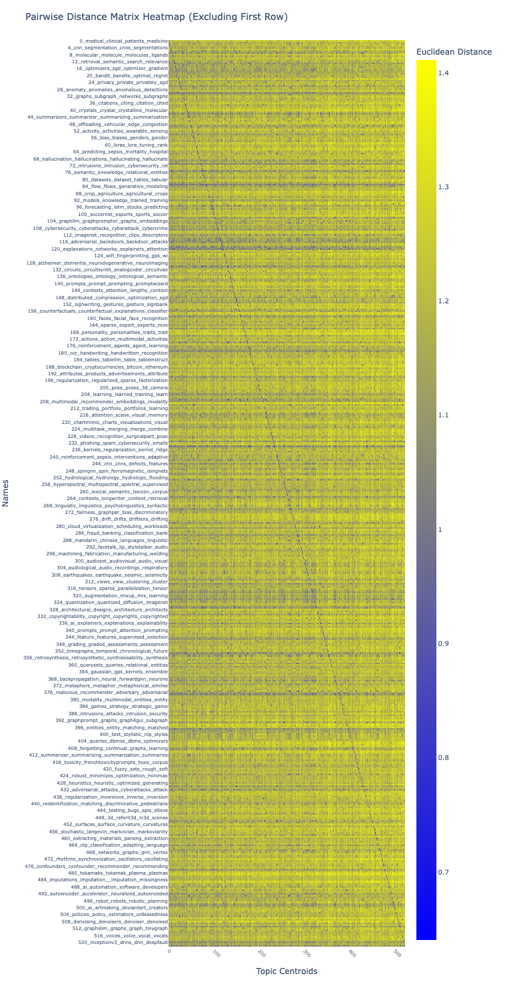

The highest value on the diagonal contributes 0.24% to the total diagonal sum.


In [8]:
import pandas as pd
from sentence_transformers import SentenceTransformer
import numpy as np
from sklearn.metrics.pairwise import euclidean_distances
import plotly.express as px
import plotly.io as pio

# Load the datasets
second_step = pd.read_csv('First_Step_BERTopic_topic_info_labelled.csv')
bertopic_result = pd.read_csv('First_Step_BERTopic_result.csv')

# Initialize the sentence transformer model
model = SentenceTransformer('sentence-transformers/all-MiniLM-L6-v2')

# Group by Topic and calculate centroids of text embeddings
grouped = bertopic_result.groupby('Topic Label')['text'].apply(list).reset_index()

def calculate_centroid(texts):
    embeddings = model.encode(texts)
    centroid = np.mean(embeddings, axis=0)
    return centroid

grouped['centroid'] = grouped['text'].apply(calculate_centroid)

# Calculate embeddings for Name in the second dataset
second_step['Name_embedding'] = second_step['Name'].apply(lambda x: model.encode(x))

# Prepare to compare all centroids with all Name embeddings
centroids = grouped[['Topic Label', 'centroid']]
name_embeddings = second_step[['Name', 'Name_embedding']]

# Exclude the first row from both centroids and names (assuming they are outliers)
centroids_limited = centroids.iloc[1:]  # Exclude only the first row
name_embeddings_limited = name_embeddings.iloc[1:]  # Exclude only the first row

# Initialize a matrix to store the pairwise Euclidean distances
distance_matrix = np.zeros((len(name_embeddings_limited), len(centroids_limited)))

# Calculate the Euclidean distance for each pair (Name vs. Topic Centroid)
for i, name_embedding in enumerate(name_embeddings_limited['Name_embedding']):
    for j, centroid in enumerate(centroids_limited['centroid']):
        distance = euclidean_distances([name_embedding], [centroid])[0][0]
        distance_matrix[i, j] = distance

# Convert the distance matrix to a DataFrame for better readability
distance_df_limited = pd.DataFrame(distance_matrix, 
                                   index=name_embeddings_limited['Name'], 
                                   columns=centroids_limited['Topic Label'])

# Save the limited distance DataFrame to a CSV file
distance_df_limited.to_csv('first_step_pairwise_euclidean_distance_heatmap_all_except_first.csv', index=True)

# Create an interactive heatmap for the limited data with a new color scale
fig = px.imshow(distance_df_limited,
                labels=dict(x="Topic Centroids", y="Names", color="Euclidean Distance"),
                x=distance_df_limited.columns,
                y=distance_df_limited.index,
                color_continuous_scale=['blue', 'yellow'],  # Custom gradient from blue to yellow
                text_auto=True)

# Adjust layout and ensure visibility
fig.update_layout(title='Pairwise Distance Matrix Heatmap (Excluding First Row)',
                  xaxis_title='Topic Centroids',
                  yaxis_title='Names',
                  width=1500,
                  height=1500,
                  font=dict(size=10))  # Adjust font size here if needed

# Update x-axis layout to ensure all labels are visible
fig.update_xaxes(automargin=True,
                 tickangle=45,  # Adjust the angle of x-axis labels
                 tickfont=dict(size=7))  # Adjust the font size of x-axis labels

# Update y-axis layout to ensure all labels are visible
fig.update_yaxes(automargin=True,
                 tickangle=0,  # Adjust the angle of y-axis labels
                 tickfont=dict(size=7))  # Adjust the font size of y-axis labels

# Save the figure as an interactive HTML file
pio.write_html(fig, file='first_step_pairwise_euclidean_distance_heatmap_all_except_first.html', auto_open=False)

# Save the figure as a static image (e.g., PNG)
pio.write_image(fig, file='first_step_pairwise_euclidean_distance_heatmap_all_except_first.png', format='png', width=1500, height=1500, scale=3)

# Display the heatmap
fig.show()

# --- Additional: Calculate the highest value percentage on the diagonal ---

# Extract diagonal values
diagonal_values = np.diagonal(distance_matrix)

# Find the highest value on the diagonal
max_diagonal_value = np.max(diagonal_values)

# Calculate the total sum of diagonal values
total_diagonal_sum = np.sum(diagonal_values)

# Calculate the percentage of the highest diagonal value
percentage_max_diagonal = (max_diagonal_value / total_diagonal_sum) * 100

# Print the result
print(f"The highest value on the diagonal contributes {percentage_max_diagonal:.2f}% to the total diagonal sum.")


In [9]:
import numpy as np

# Assuming similarity_matrix is already calculated as cosine similarity between embeddings
# Extract diagonal values
diagonal_values = np.diagonal(similarity_matrix)

# Initialize a counter for rows where the diagonal value is the highest
diagonal_highest_count = 0

# Iterate over each row in the similarity matrix
for i in range(similarity_matrix.shape[0]):
    row = similarity_matrix[i, :]
    diagonal_value = diagonal_values[i]
    
    # Check if the diagonal value is the highest in the row
    if diagonal_value == np.max(row):
        diagonal_highest_count += 1

# Calculate the total number of rows
total_rows = similarity_matrix.shape[0]

# Calculate the percentage of rows where the diagonal value is the highest
percentage_diagonal_highest = (diagonal_highest_count / total_rows) * 100

# Print the evaluation result
print(f"The diagonal similarity is the highest in {diagonal_highest_count} out of {total_rows} cases.")
print(f"Percentage of cases where the diagonal similarity is the highest: {percentage_diagonal_highest:.2f}%")


The lowest value on the diagonal is 0.6405256390571594.
The lowest value on the diagonal contributes 0.13% to the total diagonal sum.


/w0/tmp/slurm_yc656703.49807071/ipykernel_247670/2647644559.py:10: DtypeWarning:

Columns (0) have mixed types. Specify dtype option on import or set low_memory=False.

/home/yc656703/.local/lib/python3.9/site-packages/huggingface_hub/file_download.py:1132: FutureWarning:

`resume_download` is deprecated and will be removed in version 1.0.0. Downloads always resume when possible. If you want to force a new download, use `force_download=True`.



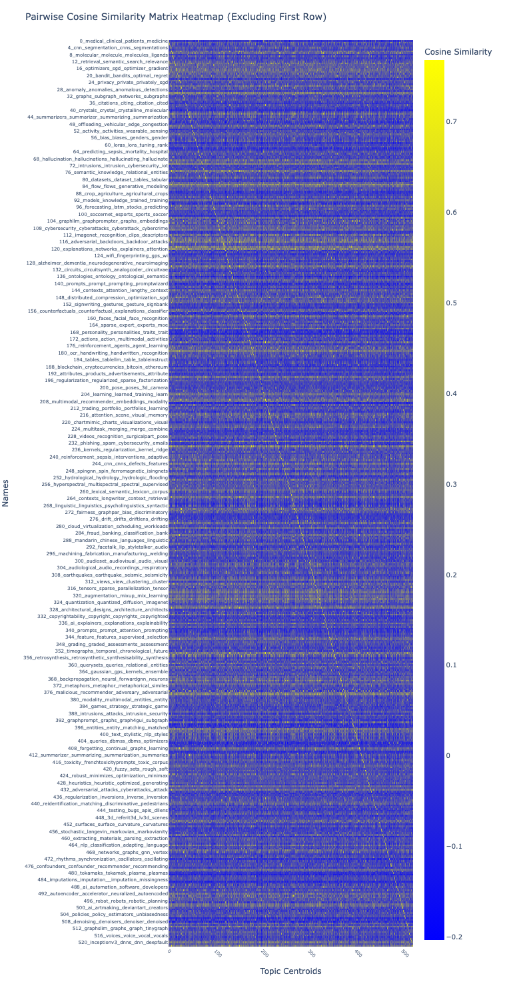

The highest value on the diagonal appears 1 times.
The highest value on the diagonal contributes 0.30% to the total diagonal sum.


In [12]:
import pandas as pd
from sentence_transformers import SentenceTransformer
import numpy as np
from sklearn.metrics.pairwise import cosine_similarity
import plotly.express as px
import plotly.io as pio

# Load the datasets
second_step = pd.read_csv('First_Step_BERTopic_topic_info_labelled.csv')
bertopic_result = pd.read_csv('First_Step_BERTopic_result.csv')

# Initialize the sentence transformer model
model = SentenceTransformer('sentence-transformers/all-MiniLM-L6-v2')

# Group by Topic and calculate centroids of text embeddings
grouped = bertopic_result.groupby('Topic Label')['text'].apply(list).reset_index()

def calculate_centroid(texts):
    embeddings = model.encode(texts)
    centroid = np.mean(embeddings, axis=0)
    return centroid

grouped['centroid'] = grouped['text'].apply(calculate_centroid)

# Calculate embeddings for Name in the second dataset
second_step['Name_embedding'] = second_step['Name'].apply(lambda x: model.encode(x))

# Prepare to compare all centroids with all Name embeddings
centroids = grouped[['Topic Label', 'centroid']]
name_embeddings = second_step[['Name', 'Name_embedding']]

# Exclude the first row from both centroids and names (assuming they are outliers)
centroids_limited = centroids.iloc[1:]  # Exclude only the first row
name_embeddings_limited = name_embeddings.iloc[1:]  # Exclude only the first row

# Initialize a matrix to store the pairwise cosine similarity scores
similarity_matrix = np.zeros((len(name_embeddings_limited), len(centroids_limited)))

# Calculate the cosine similarity for each pair (Name vs. Topic Centroid)
for i, name_embedding in enumerate(name_embeddings_limited['Name_embedding']):
    for j, centroid in enumerate(centroids_limited['centroid']):
        similarity = cosine_similarity([name_embedding], [centroid])[0][0]
        similarity_matrix[i, j] = similarity

# Convert the similarity matrix to a DataFrame for better readability
similarity_df_limited = pd.DataFrame(similarity_matrix, 
                                     index=name_embeddings_limited['Name'], 
                                     columns=centroids_limited['Topic Label'])

# Save the limited similarity DataFrame to a CSV file
similarity_df_limited.to_csv('first_step_pairwise_cosine_similarity_heatmap_all_except_first.csv', index=True)

# Create an interactive heatmap for the limited data with a new color scale
fig = px.imshow(similarity_df_limited,
                labels=dict(x="Topic Centroids", y="Names", color="Cosine Similarity"),
                x=similarity_df_limited.columns,
                y=similarity_df_limited.index,
                color_continuous_scale=['blue', 'yellow'],  # Custom gradient from blue to yellow
                text_auto=True)

# Adjust layout and ensure visibility
fig.update_layout(title='Pairwise Cosine Similarity Matrix Heatmap (Excluding First Row)',
                  xaxis_title='Topic Centroids',
                  yaxis_title='Names',
                  width=1500,
                  height=1500,
                  font=dict(size=10))  # Adjust font size here if needed

# Update x-axis layout to ensure all labels are visible
fig.update_xaxes(automargin=True,
                 tickangle=45,  # Adjust the angle of x-axis labels
                 tickfont=dict(size=7))  # Adjust the font size of x-axis labels

# Update y-axis layout to ensure all labels are visible
fig.update_yaxes(automargin=True,
                 tickangle=0,  # Adjust the angle of y-axis labels
                 tickfont=dict(size=7))  # Adjust the font size of y-axis labels

# Save the figure as an interactive HTML file
pio.write_html(fig, file='first_step_pairwise_cosine_similarity_heatmap_all_except_first.html', auto_open=False)

# Save the figure as a static image (e.g., PNG)
pio.write_image(fig, file='first_step_pairwise_cosine_similarity_heatmap_all_except_first.png', format='png', width=1500, height=1500, scale=3)

# Display the heatmap
fig.show()

# --- Additional: Calculate the highest value on the diagonal for cosine similarity ---

# Extract diagonal values
diagonal_values = np.diagonal(similarity_matrix)

# Find the highest value on the diagonal (since we're using cosine similarity)
max_diagonal_value = np.max(diagonal_values)

# Calculate how many times the highest value appears on the diagonal
max_value_count = np.sum(diagonal_values == max_diagonal_value)

# Calculate the total sum of diagonal values
total_diagonal_sum = np.sum(diagonal_values)

# Calculate the percentage of the highest diagonal value
percentage_max_diagonal = (max_diagonal_value / total_diagonal_sum) * 100

# Print the results
print(f"The highest value on the diagonal appears {max_value_count} times.")
print(f"The highest value on the diagonal contributes {percentage_max_diagonal:.2f}% to the total diagonal sum.")

import numpy as np

# Assuming similarity_matrix is already calculated as cosine similarity between embeddings
# Extract diagonal values
diagonal_values = np.diagonal(similarity_matrix)

# Initialize a counter for rows where the diagonal value is the highest
diagonal_highest_count = 0

# Iterate over each row in the similarity matrix
for i in range(similarity_matrix.shape[0]):
    row = similarity_matrix[i, :]
    diagonal_value = diagonal_values[i]
    
    # Check if the diagonal value is the highest in the row
    if diagonal_value == np.max(row):
        diagonal_highest_count += 1

# Calculate the total number of rows
total_rows = similarity_matrix.shape[0]

# Calculate the percentage of rows where the diagonal value is the highest
percentage_diagonal_highest = (diagonal_highest_count / total_rows) * 100

# Print the evaluation result
print(f"The diagonal similarity is the highest in {diagonal_highest_count} out of {total_rows} cases.")
print(f"Percentage of cases where the diagonal similarity is the highest: {percentage_diagonal_highest:.2f}%")



In [16]:
import numpy as np

# Assuming similarity_matrix is already calculated as cosine similarity between embeddings
# Extract diagonal values
diagonal_values = np.diagonal(similarity_matrix)

# Initialize a counter for rows where the diagonal value is the highest
diagonal_highest_count = 0

# Iterate over each row in the similarity matrix
for i in range(similarity_matrix.shape[0]):
    row = similarity_matrix[i, :]
    diagonal_value = diagonal_values[i]
    
    # Check if the diagonal value is the highest in the row
    if diagonal_value == np.max(row):
        diagonal_highest_count += 1

# Calculate the total number of rows
total_rows = similarity_matrix.shape[0]

# Calculate the percentage of rows where the diagonal value is the highest
percentage_diagonal_highest = (diagonal_highest_count / total_rows) * 100

# Print the evaluation result
print(f"The diagonal similarity is the highest in {diagonal_highest_count} out of {total_rows} cases.")
print(f"Percentage of cases where the diagonal similarity is the highest: {percentage_diagonal_highest:.2f}%")


The diagonal similarity is the highest in 422 out of 523 cases.
Percentage of cases where the diagonal similarity is the highest: 80.69%


/w0/tmp/slurm_yc656703.49807071/ipykernel_247670/2260635910.py:10: DtypeWarning:

Columns (0) have mixed types. Specify dtype option on import or set low_memory=False.

/home/yc656703/.local/lib/python3.9/site-packages/huggingface_hub/file_download.py:1132: FutureWarning:

`resume_download` is deprecated and will be removed in version 1.0.0. Downloads always resume when possible. If you want to force a new download, use `force_download=True`.



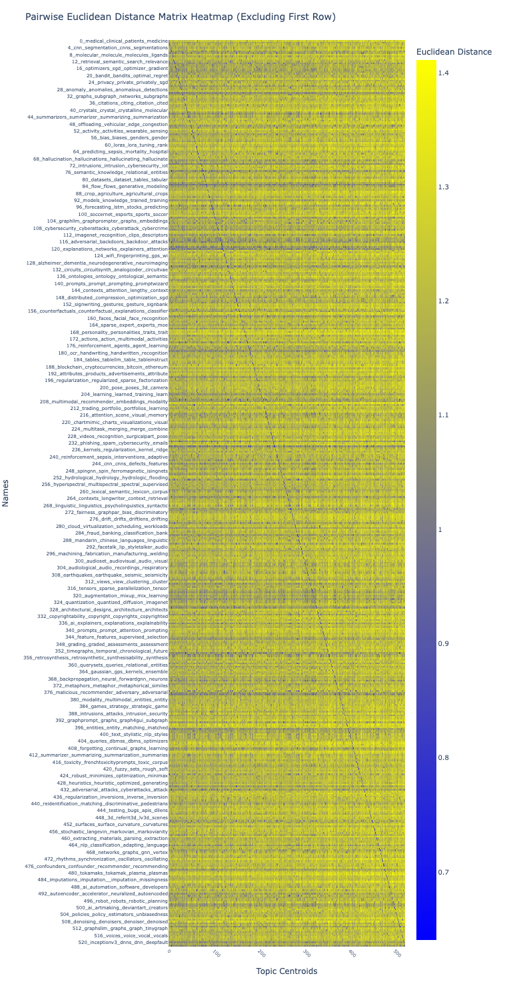

The lowest value on the diagonal appears 1 times.
The lowest value on the diagonal contributes 0.13% to the total diagonal sum.
The diagonal distance is the smallest in 406 out of 523 cases.
Percentage of cases where the diagonal distance is the smallest: 77.63%


In [17]:
import pandas as pd
from sentence_transformers import SentenceTransformer
import numpy as np
from sklearn.metrics.pairwise import euclidean_distances
import plotly.express as px
import plotly.io as pio

# Load the datasets
second_step = pd.read_csv('First_Step_BERTopic_topic_info_labelled.csv')
bertopic_result = pd.read_csv('First_Step_BERTopic_result.csv')

# Initialize the sentence transformer model
model = SentenceTransformer('sentence-transformers/all-MiniLM-L6-v2')

# Group by Topic and calculate centroids of text embeddings
grouped = bertopic_result.groupby('Topic Label')['text'].apply(list).reset_index()

def calculate_centroid(texts):
    embeddings = model.encode(texts)
    centroid = np.mean(embeddings, axis=0)
    return centroid

grouped['centroid'] = grouped['text'].apply(calculate_centroid)

# Calculate embeddings for Name in the second dataset
second_step['Name_embedding'] = second_step['Name'].apply(lambda x: model.encode(x))

# Prepare to compare all centroids with all Name embeddings
centroids = grouped[['Topic Label', 'centroid']]
name_embeddings = second_step[['Name', 'Name_embedding']]

# Exclude the first row from both centroids and names (assuming they are outliers)
centroids_limited = centroids.iloc[1:]  # Exclude only the first row
name_embeddings_limited = name_embeddings.iloc[1:]  # Exclude only the first row

# Initialize a matrix to store the pairwise Euclidean distance scores
distance_matrix = np.zeros((len(name_embeddings_limited), len(centroids_limited)))

# Calculate the Euclidean distance for each pair (Name vs. Topic Centroid)
for i, name_embedding in enumerate(name_embeddings_limited['Name_embedding']):
    for j, centroid in enumerate(centroids_limited['centroid']):
        distance = euclidean_distances([name_embedding], [centroid])[0][0]
        distance_matrix[i, j] = distance

# Convert the distance matrix to a DataFrame for better readability
distance_df_limited = pd.DataFrame(distance_matrix, 
                                   index=name_embeddings_limited['Name'], 
                                   columns=centroids_limited['Topic Label'])

# Save the limited distance DataFrame to a CSV file
distance_df_limited.to_csv('first_step_pairwise_euclidean_distance_heatmap_all_except_first.csv', index=True)

# Create an interactive heatmap for the limited data with a new color scale
fig = px.imshow(distance_df_limited,
                labels=dict(x="Topic Centroids", y="Names", color="Euclidean Distance"),
                x=distance_df_limited.columns,
                y=distance_df_limited.index,
                color_continuous_scale=['blue', 'yellow'],  # Custom gradient from blue to yellow
                text_auto=True)

# Adjust layout and ensure visibility
fig.update_layout(title='Pairwise Euclidean Distance Matrix Heatmap (Excluding First Row)',
                  xaxis_title='Topic Centroids',
                  yaxis_title='Names',
                  width=1500,
                  height=1500,
                  font=dict(size=10))  # Adjust font size here if needed

# Update x-axis layout to ensure all labels are visible
fig.update_xaxes(automargin=True,
                 tickangle=45,  # Adjust the angle of x-axis labels
                 tickfont=dict(size=7))  # Adjust the font size of x-axis labels

# Update y-axis layout to ensure all labels are visible
fig.update_yaxes(automargin=True,
                 tickangle=0,  # Adjust the angle of y-axis labels
                 tickfont=dict(size=7))  # Adjust the font size of y-axis labels

# Save the figure as an interactive HTML file
pio.write_html(fig, file='first_step_pairwise_euclidean_distance_heatmap_all_except_first.html', auto_open=False)

# Save the figure as a static image (e.g., PNG)
pio.write_image(fig, file='first_step_pairwise_euclidean_distance_heatmap_all_except_first.png', format='png', width=1500, height=1500, scale=3)

# Display the heatmap
fig.show()

# --- Additional: Evaluate Euclidean distance results ---

# Extract diagonal values (representing Name's embedding vs. Topic Centroid embedding of same index)
diagonal_values = np.diagonal(distance_matrix)

# Find the lowest value on the diagonal (since we're using Euclidean distance, lower values are better)
min_diagonal_value = np.min(diagonal_values)

# Calculate how many times the lowest value appears on the diagonal
min_value_count = np.sum(diagonal_values == min_diagonal_value)

# Calculate the total sum of diagonal values
total_diagonal_sum = np.sum(diagonal_values)

# Calculate the percentage of the lowest diagonal value
percentage_min_diagonal = (min_diagonal_value / total_diagonal_sum) * 100

# Print the results
print(f"The lowest value on the diagonal appears {min_value_count} times.")
print(f"The lowest value on the diagonal contributes {percentage_min_diagonal:.2f}% to the total diagonal sum.")

# --- Additional: Count how often diagonal values are the smallest in their row ---
diagonal_smallest_count = 0

# Iterate over each row in the distance matrix
for i in range(distance_matrix.shape[0]):
    row = distance_matrix[i, :]
    diagonal_value = diagonal_values[i]
    
    # Check if the diagonal value is the smallest in the row
    if diagonal_value == np.min(row):
        diagonal_smallest_count += 1

# Calculate the total number of rows
total_rows = distance_matrix.shape[0]

# Calculate the percentage of rows where the diagonal value is the smallest
percentage_diagonal_smallest = (diagonal_smallest_count / total_rows) * 100

# Print the evaluation result
print(f"The diagonal distance is the smallest in {diagonal_smallest_count} out of {total_rows} cases.")
print(f"Percentage of cases where the diagonal distance is the smallest: {percentage_diagonal_smallest:.2f}%")
